## Import

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

Plotly Express
----------------------------------

*   The `plotly.express` module (usually imported as `px`) contains functions that can create entire figures at once.
*   Every Plotly Express function uses [graph objects](https://plotly.com/python/graph-objects/) internally and returns a `plotly.graph_objects.Figure` instance.
*   Plotly Express provides [more than 30 functions for creating different types of figures](https://plotly.com/python-api-reference/plotly.express.html).
*   The API for these functions was carefully designed to be as consistent and easy to learn


#### Plotly Express currently includes the following functions:[¶](#Plotly-Express-currently-includes-the-following-functions:)

*   **Basics**: [`scatter`](https://plotly.com/python/line-and-scatter/), [`line`](https://plotly.com/python/line-charts/), [`area`](https://plotly.com/python/filled-area-plots/), [`bar`](https://plotly.com/python/bar-charts/), [`funnel`](https://plotly.com/python/funnel-charts/), [`timeline`](https://plotly.com/python/gantt/)
*   **Part-of-Whole**: [`pie`](https://plotly.com/python/pie-charts/), [`sunburst`](https://plotly.com/python/sunburst-charts/), [`treemap`](https://plotly.com/python/treemaps/), [`icicle`](https://plotly.com/python/icicle-charts/), [`funnel_area`](https://plotly.com/python/funnel-charts/)
*   **1D Distributions**: [`histogram`](https://plotly.com/python/histograms/), [`box`](https://plotly.com/python/box-plots/), [`violin`](https://plotly.com/python/violin/), [`strip`](https://plotly.com/python/strip-charts/), [`ecdf`](https://plotly.com/python/ecdf-plots/)
*   **2D Distributions**: [`density_heatmap`](https://plotly.com/python/2D-Histogram/), [`density_contour`](https://plotly.com/python/2d-histogram-contour/)
*   **Matrix or Image Input**: [`imshow`](https://plotly.com/python/imshow/)
*   **3-Dimensional**: [`scatter_3d`](https://plotly.com/python/3d-scatter-plots/), [`line_3d`](https://plotly.com/python/3d-line-plots/)
*   **Multidimensional**: [`scatter_matrix`](https://plotly.com/python/splom/), [`parallel_coordinates`](https://plotly.com/python/parallel-coordinates-plot/), [`parallel_categories`](https://plotly.com/python/parallel-categories-diagram/)
*   **Tile Maps**: [`scatter_map`](https://plotly.com/python/tile-scatter-maps/), [`line_map`](https://plotly.com/python/lines-on-tile-maps/), [`choropleth_map`](https://plotly.com/python/tile-county-choropleth/), [`density_map`](https://plotly.com/python/tile-density-heatmaps/)
*   **Outline Maps**: [`scatter_geo`](https://plotly.com/python/scatter-plots-on-maps/), [`line_geo`](https://plotly.com/python/lines-on-maps/), [`choropleth`](https://plotly.com/python/choropleth-maps/)
*   **Polar Charts**: [`scatter_polar`](https://plotly.com/python/polar-chart/), [`line_polar`](https://plotly.com/python/polar-chart/), [`bar_polar`](https://plotly.com/python/wind-rose-charts/)
*   **Ternary Charts**: [`scatter_ternary`](https://plotly.com/python/ternary-plots/), [`line_ternary`](https://plotly.com/python/ternary-plots/)


Using Plotly's built in dataset for demonstration
--------------------------------------------------------------------------------------------------------

> [plotly.data](https://plotly.com/python-api-reference/generated/plotly.data.html)

[Line Plot](https://plotly.com/python/line-charts/)
------------------------------------------------------------------

Plot to visualize time-series data

> plotly.express.line(data\_frame, x, y)

1.  **Single Line Plot** - Plot simple line for relationship b/w two variables
2.  **Multiple Line Plots** - Plot multiple line plots in single figure
3.  **Complex Line Plots** - Customizing options like mode, line, markers ...

In [2]:
df_stocks = px.data.stocks()
df_stocks.head()

,date,GOOG,AAPL,AMZN,FB,NFLX,MSFT
0,2018-01-01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-08,1.018172,1.011943,1.061881,0.959968,1.053526,1.015988
2,2018-01-15,1.032008,1.019771,1.053240,0.970243,1.049860,1.020524
3,2018-01-22,1.066783,0.980057,1.140676,1.016858,1.307681,1.066561
4,2018-01-29,1.008773,0.917143,1.163374,1.018357,1.273537,1.040708


In [3]:
px.line(
    df_stocks, 
    x='date', 
    y='NFLX', 
    labels={'x':'Date', 'y':'Price'}
)

In [4]:
px.line(
    df_stocks, 
    x='date', 
    y=['FB','NFLX'], 
    labels={'x':'Date', 'y':'Price'},
    title='FB Vs. Netflix'
)

In [5]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_stocks.date, 
    y=df_stocks.AAPL, 
    mode='lines', 
    name='Apple'
))
fig.add_trace(go.Scatter(
    x=df_stocks.date, 
    y=df_stocks.AMZN, 
    mode='lines+markers', 
    name='Amazon'
))
fig.add_trace(go.Scatter(
    x=df_stocks.date, 
    y=df_stocks.GOOG, 
    mode='lines+markers', 
    name='Google',
    line=dict(color='firebrick', width=1, dash='dashdot')
))

fig.update_layout(
    xaxis=dict(
        showline=True,
        showgrid=False,
        showticklabels=True,
        linecolor='rgb(204, 204, 204)',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Arial',
            size=12,
            color='rgb(82, 82, 82)',
        ),
    ),
    yaxis=dict(
        showgrid=False,
        zeroline=False,
        showline=False,
        showticklabels=False,
    ),
    autosize=False,
    margin=dict(
        autoexpand=False,
        l=100,
        r=20,
        t=110,
    ),
    showlegend=False,
    plot_bgcolor='white'
)


[Bar Chart](https://plotly.com/python/bar-charts/)
-----------------------------------------------------------------

Plot to visualize categorical data or the distribution of a variable.

> `plotly.express.bar(data_frame, x, y, barmode = 'relative', 'stack', 'group')`

1.  **Single Bar Plot** - A simple bar chart showing the distribution of a categorical variable.
2.  **Multiple Bar Plots** - Multiple bar charts displayed side-by-side, useful for comparing different categories or groups.
3.  **Stacked Bar Plot** - A bar chart where each bar is divided into segments to show subcategories, helping visualize the composition of each category.
4.  **Grouped Bar Plot** - A bar chart where bars representing multiple groups for each category are grouped together, ideal for comparing multiple variables across categories.
5.  **Customizing Bar Charts** - Customization options to adjust bar width, color, layout, and more to create an optimal visualization.

In [6]:
df_us = px.data.gapminder().query("country == 'United States'")
df_us.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
1608,United States,Americas,1952,68.44,157553000,13990.48208,USA,840
1609,United States,Americas,1957,69.49,171984000,14847.12712,USA,840
1610,United States,Americas,1962,70.21,186538000,16173.14586,USA,840
1611,United States,Americas,1967,70.76,198712000,19530.36557,USA,840
1612,United States,Americas,1972,71.34,209896000,21806.03594,USA,840


In [7]:
px.bar(df_us, x='year', y='pop')

In [8]:
df_tips = px.data.tips()
df_tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


In [9]:
px.bar(
    df_tips, 
    x='day', 
    y='tip', 
    color='sex', 
    title='Tips by Sex on Each Day',
    labels={'tip': 'Tip Amount', 'day': 'Day of the Week'}
)

In [10]:
px.bar(
    df_tips, 
    x="sex", 
    y="total_bill",
    color='smoker', 
    barmode='group'
)

In [11]:
df_europe = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.e7")
df_europe.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
539,France,Europe,2007,80.657,61083916,30470.01670,FRA,250
575,Germany,Europe,2007,79.406,82400996,32170.37442,DEU,276
779,Italy,Europe,2007,80.546,58147733,28569.71970,ITA,380
1235,Poland,Europe,2007,75.563,38518241,15389.92468,POL,616
1283,Romania,Europe,2007,72.476,22276056,10808.47561,ROU,642


In [12]:
fig = px.bar(
    df_europe, 
    y='pop', 
    x='country', 
    text='pop', 
    color='country'
)
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.update_layout(xaxis_tickangle=-45)

[Scatter Plot](https://plotly.com/python/line-and-scatter/)
-----------------------------------------------------------------------------

Plot to visualize the relationship between two or more continuous variables.

> `plotly.express.scatter(data_frame, x, y)`

1.  **Simple Scatter Plot** - Basic scatter plot with two continuous variables.
    
2.  **Multiple Scatter Plots** - Multiple scatter plots displayed in a single figure for multiple groups.
    
3.  **Customizing Scatter Plots** - Customization options to adjust point size, color, shape, transparency, layout, and more to refine the visualization.
    
4.  **ScatterGL** - High performance variant of the scatter plot using WebGL for faster rendering for large datasets
    
    > `plotly.express.scattergl(data_frame, x, y)`

In [13]:
df_iris = px.data.iris()
df_iris.head()

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1


In [14]:
px.scatter(df_iris, x="sepal_width", y="sepal_length")

In [15]:
px.scatter(
    df_iris, 
    x="sepal_width", 
    y="sepal_length", 
    color="species",
    size='petal_length', 
    hover_data=['petal_width']
)

In [16]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_iris.sepal_width, y=df_iris.sepal_length,
    mode='markers',
    marker_color=df_iris.sepal_width,
    text=df_iris.species,
    marker=dict(showscale=True)
))
fig.update_traces(marker_line_width=2, marker_size=10)

In [17]:
fig = go.Figure()
fig = go.Figure(data=go.Scattergl(
    x = np.random.randn(100000),
    y = np.random.randn(100000),
    mode='markers',
    marker=dict(
        color=np.random.randn(100000),
        colorscale='Viridis',
        line_width=1
    )
))
fig.update_traces(marker_line_width=2, marker_size=10)

[Histograms](https://plotly.com/python/histograms/)
-------------------------------------------------------------------

Plot to visualize distribution of single continuous variable

> `plotly.express.histogram(data_frame, x, y, nbins, ...)`

1.  **Simple Histogram** - Basic histogram for distribution for a continuous variable.
2.  **Stacked Histogram** - Stacking histograms on top of other.

In [18]:
dice_sum = np.random.randint(1,7,5000) + np.random.randint(1,7,5000)
fig = px.histogram(
    dice_sum, 
    nbins=11, 
    labels={'value':'Dice Roll'},
    title='5000 Dice Roll Histogram', 
    marginal='violin',
    color_discrete_sequence=['salmon']
)
fig.update_layout(
    xaxis_title_text='Dice Roll',
    yaxis_title_text='Dice Sum',
    bargap=0.2, showlegend=False
)

In [19]:
px.histogram(df_tips, x="total_bill", color="sex")

[Box plots](https://plotly.com/python/box-plots/)
----------------------------------------------------------------

Plot to visualize distribution of continuous variable by showing median, quartiles, and outliers

> `plotly.express.box(data_frame, x, y, color, points, ...)`

1.  **Simple Box plot** - Simple box plot with one continuous variable.
2.  **Multiple Box plot** - Multiple box plots in one figure.
3.  **Customized Box plot** - Customizing options with fillcolor, jitter, whiskerwidth

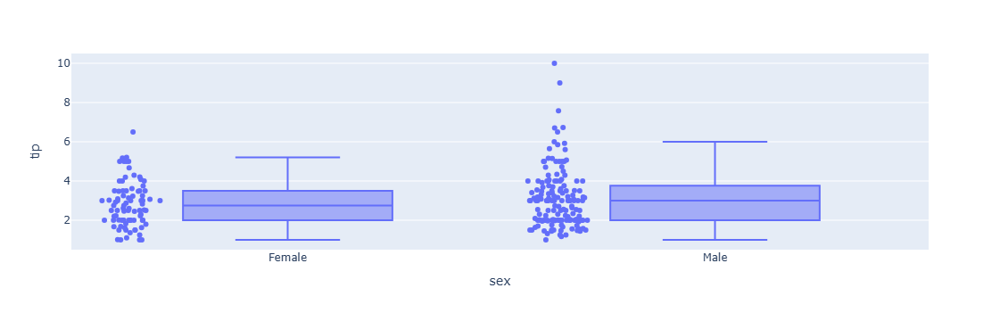

In [20]:
px.box(df_tips, x='sex', y='tip', points='all')

In [21]:
px.box(df_tips, x='day', y='tip', color='sex')

In [22]:
fig = go.Figure()
fig.add_trace(go.Box(
    y=df_stocks.GOOG, 
    boxpoints='all', 
    name='Google',
    fillcolor='blue', 
    jitter=0.5, 
    whiskerwidth=0.2
))
fig.add_trace(go.Box(
    y=df_stocks.AAPL, 
    boxpoints='all', 
    name='Apple',
    fillcolor='red', 
    jitter=0.5, 
    whiskerwidth=0.2
))
fig.update_layout(
    title='Google vs. Apple', 
    yaxis=dict(gridcolor='rgb(255, 255, 255)', gridwidth=3),
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)'
)

[Violin plot](https://plotly.com/python/violin/)
-----------------------------------------------------------------------------------------------------------------------------------------------

Plot for combination of box plots and kernel density, to visualize data's density

> `plotly.express.box(data_frame, x, y, color, points, ...)`

1.  **Simple Violin plot** - Simple violin plot with single continuous plot.
2.  **Multiple Violin plot** - Multiple violin plots displayed in a figure.
3.  **Customized Violin plot** - Customizing options with legendgroup, scalegroup, side, box.


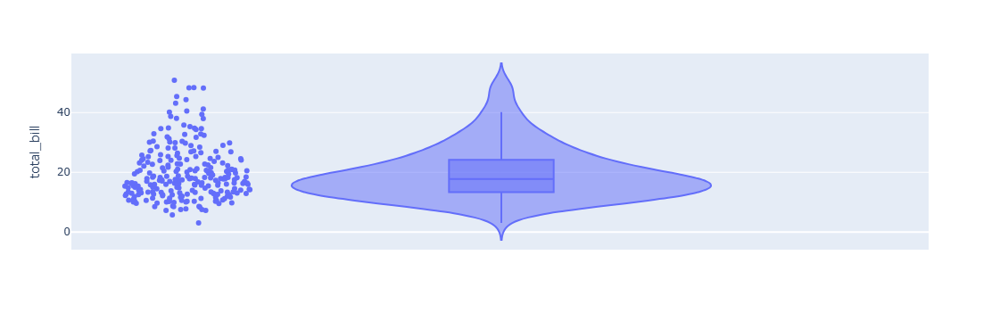

In [23]:
px.violin(df_tips, y="total_bill", box=True, points='all')

In [24]:
px.violin(
    df_tips, 
    y="tip", 
    x="smoker", 
    color="sex", 
    points="all",
    box = True,
    hover_data=df_tips.columns
)

In [25]:
fig = go.Figure()
fig.add_trace(go.Violin(
    x=df_tips['day'][df_tips['smoker'] == 'Yes'],
    y=df_tips['total_bill'][df_tips['smoker'] == 'Yes'],
    legendgroup='Yes',
    scalegroup='Yes',
    name='Yes',
    side='negative',
    line_color='blue'
))
fig.add_trace(go.Violin(
    x=df_tips['day'][df_tips['smoker'] == 'No'],
    y=df_tips['total_bill'][df_tips['smoker'] == 'No'],
    legendgroup='No',
    scalegroup='No',
    name='No',
    side='positive',
    line_color='red'
))

[Density Heatmap](https://plotly.com/python/heatmaps/)
---------------------------------------------------------------------------

Plot to visualize the concentration of data points in a 2D space

> `plotly.express.density_heatmap(data_frame, x, y, z)`

1.  **Density Heatmap** - Heatmap for passengers across years and over months.
2.  **Density Heatmap with Histogram** - Heatmap with histogram on axes.
    
    > `plotly.express.density_heatmap(data_frame, x, y, marginal_x, marginal_y)`

In [26]:
flights = sns.load_dataset("flights")
flights.head()

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121


In [27]:
px.density_heatmap(
    flights, 
    x='year', 
    y='month', 
    z='passengers',
    color_continuous_scale="Viridis"
)

In [28]:
px.density_heatmap(
    flights, 
    x='year', 
    y='month', 
    z='passengers',
    marginal_x="histogram", 
    marginal_y="histogram", 
)

[3D Plots](https://plotly.com/python/3d-charts/)[¶](#3D-Plots)
--------------------------------------------------------------

Plot to visualize the of 3 varaiables in 3 dimension

> `plotly.express.scatter_3d(data_frame, x, y, z)`

1.  **3D Scatter plot** - Relationship between three continuous variables.
2.  **3D Line plot** - Relationship between three continuous variable for times seris data.

In [29]:
px.scatter_3d(
    flights, 
    x='year', 
    y='month', 
    z='passengers', 
    color='year',
    opacity=0.7, 
    width=800, 
    height=400
)

In [30]:
px.line_3d(
    flights, 
    x='year', 
    y='month', 
    z='passengers', 
    color='year'
)

[Map Scatter plot](https://plotly.com/python/scatter-plots-on-maps/)
------------------------------------------------------------------------------------------

Geographical scatter plot

> `plotly.express.scatter_geo(data_frame, x, size, projection)`

In [31]:
df = px.data.gapminder().query("year == 2007")
df.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32


In [32]:
px.scatter_geo(
    df, 
    locations="iso_alpha",
    color="continent", 
    hover_name="country",
    size="pop",
    projection="natural earth"
)

[Animated Plots](https://plotly.com/python/animations/)[¶](#Animated-Plots)
---------------------------------------------------------------------------

1.  Plot graphs normally
    
2.  By using arguments
    
    > *   animation\_frame - To specify variable that will control the animation
    > *   animation\_group - Groups data points together for animation across frames

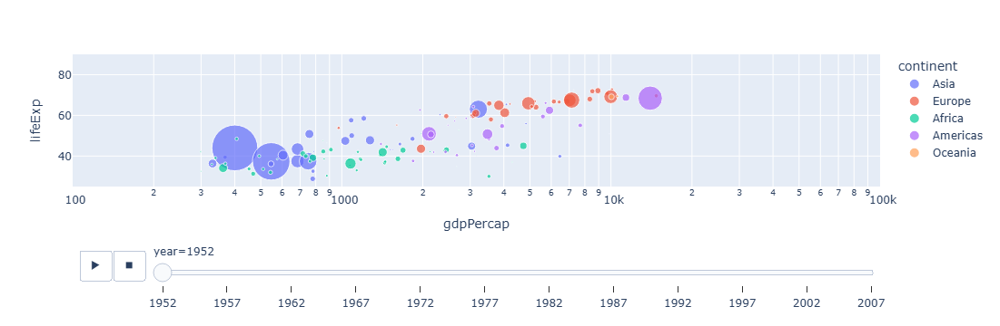

In [33]:
df_cnt = px.data.gapminder()
px.scatter(
    df_cnt, 
    x="gdpPercap", 
    y="lifeExp", 
    animation_frame="year", 
    animation_group="country",
    size="pop", 
    color="continent", 
    hover_name="country",
    log_x=True, 
    size_max=55, 
    range_x=[100,100000], 
    range_y=[25,90]
)

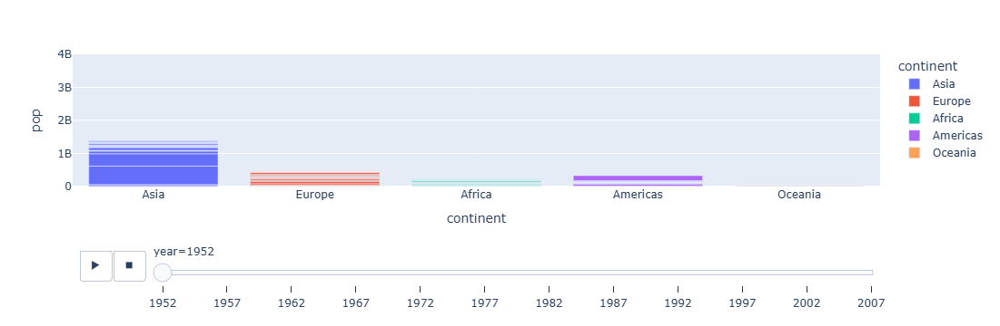

In [34]:
px.bar(
    df_cnt, 
    x="continent", 
    y="pop", 
    color="continent",
    animation_frame="year", 
    animation_group="country", 
    range_y=[0,4000000000]
)